## 📖 Imports

In [ ]:
import pandas as pd
import seaborn as sns
from datetime import datetime
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

## Data Format

### 📁 Read Dataset

In [3]:
df = pd.read_csv(
    r".././data/raw/df_full.csv",
    sep=","
)

In [4]:
df.shape

(66540, 15)

### ✏️ Rename Columns

In [5]:
df = df.rename(
    columns={
        "Timestamp": "ts_collect",
        "S1_1": "canal1_sensor1",
        "S1_2": "canal1_sensor2",
        "S1_3": "canal1_sensor3",
        "S1_4": "canal1_sensor4",
        "S1_5": "canal1_sensor5",
        "S1_6": "canal1_sensor6",
        "S2_1": "canal2_sensor1",
        "S2_2": "canal2_sensor2",
        "S3_1": "canal3_sensor1",
        "S3_2": "canal3_sensor2",
        "S4_1": "canal4_sensor1",
        "S4_2": "canal4_sensor2",
        "Nivel_agua": "water_level",
        "Nivel_total": "total_level"
    }
)

In [6]:
df.shape

(66540, 15)

### 📅 Format Date

In [7]:
df["ts_collect"] = pd.to_datetime(pd.to_datetime(df["ts_collect"]).dt.strftime("%Y-%m-%d %H:%M:%S"))

/var/folders/t1/b4n143jx5w7d98nzjl9qs8sw0000gn/T/ipykernel_46165/1891586890.py:1: UserWarning: Parsing dates in %d/%m/%Y %H:%M:%S.%f format when dayfirst=False (the default) was specified. Pass `dayfirst=True` or specify a format to silence this warning.
  df["ts_collect"] = pd.to_datetime(pd.to_datetime(df["ts_collect"]).dt.strftime("%Y-%m-%d %H:%M:%S"))


In [8]:
df.shape

(66540, 15)

### ❕ Creating Column Difference between Total Level and Water Level

In [9]:
df["diff_level"] = df["total_level"] - df["water_level"]

In [10]:
df.shape

(66540, 16)

### Safe Data in Parquet file

In [11]:
df.to_parquet(
    r".././data/processing/dataset_clean.parquet",
    index=False
)

## Data Analytics

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 66540 entries, 0 to 66539
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   ts_collect      66540 non-null  datetime64[ns]
 1   canal1_sensor1  66540 non-null  float64       
 2   canal1_sensor2  66540 non-null  float64       
 3   canal1_sensor3  66540 non-null  float64       
 4   canal1_sensor4  66540 non-null  float64       
 5   canal1_sensor5  66540 non-null  float64       
 6   canal1_sensor6  66540 non-null  float64       
 7   canal2_sensor1  66540 non-null  float64       
 8   canal2_sensor2  66540 non-null  float64       
 9   canal3_sensor1  66540 non-null  float64       
 10  canal3_sensor2  66540 non-null  float64       
 11  canal4_sensor1  66540 non-null  float64       
 12  canal4_sensor2  66540 non-null  float64       
 13  water_level     66540 non-null  float64       
 14  total_level     66540 non-null  float64       
 15  di

### Describe

In [13]:
df.describe()

,ts_collect,canal1_sensor1,canal1_sensor2,canal1_sensor3,canal1_sensor4,canal1_sensor5,canal1_sensor6,canal2_sensor1,canal2_sensor2,canal3_sensor1,canal3_sensor2,canal4_sensor1,canal4_sensor2,water_level,total_level,diff_level
count,66540,66540.000000,66540.000000,66540.000000,66540.000000,66540.000000,66540.000000,66540.000000,66540.000000,66540.000000,66540.000000,66540.000000,66540.000000,66540.000000,66540.000000,66540.000000
mean,2022-03-30 10:14:35.525067776,1524.134287,1524.730478,1530.291499,1538.683594,1552.585198,1553.321983,1531.088692,1539.395152,1544.837456,1550.519120,1545.308524,1558.082188,1245.555020,1596.034836,350.479817
min,2022-03-28 14:14:42,1523.876580,1524.632450,1530.188590,1538.571820,1552.386530,1553.097760,1530.652050,1539.029490,1544.519990,1550.201170,1545.027500,1545.204630,109.000000,109.000000,0.000000
25%,2022-03-29 10:52:03,1524.089350,1524.688170,1530.248818,1538.641880,1552.556660,1553.277568,1531.038010,1539.360270,1544.746688,1550.397470,1545.222540,1559.539840,791.000000,1287.000000,0.000000
50%,2022-03-30 14:58:16,1524.128870,1524.720210,1530.281990,1538.672615,1552.571130,1553.290640,1531.080450,1539.386375,1544.843610,1550.510815,1545.287020,1559.679345,1219.000000,1656.000000,308.000000
75%,2022-03-31 13:58:29.249999872,1524.160922,1524.765310,1530.314970,1538.705990,1552.584570,1553.333610,1531.185390,1539.425900,1544.924012,1550.622420,1545.383850,1559.762980,1880.000000,2188.000000,640.000000
max,2022-04-01 14:41:30,1524.299000,1524.905580,1530.464740,1538.917920,1552.823080,1553.571740,1531.635210,1540.003880,1545.096100,1550.912600,1545.873190,1560.415660,2804.000000,2804.000000,981.000000
std,NaN,0.054754,0.055615,0.056080,0.065582,0.060931,0.076920,0.166813,0.158077,0.110521,0.150314,0.151640,4.585039,734.131379,745.587549,366.389300


In [14]:
df.columns

Index(['ts_collect', 'canal1_sensor1', 'canal1_sensor2', 'canal1_sensor3',
       'canal1_sensor4', 'canal1_sensor5', 'canal1_sensor6', 'canal2_sensor1',
       'canal2_sensor2', 'canal3_sensor1', 'canal3_sensor2', 'canal4_sensor1',
       'canal4_sensor2', 'water_level', 'total_level', 'diff_level'],
      dtype='object')

### Hist

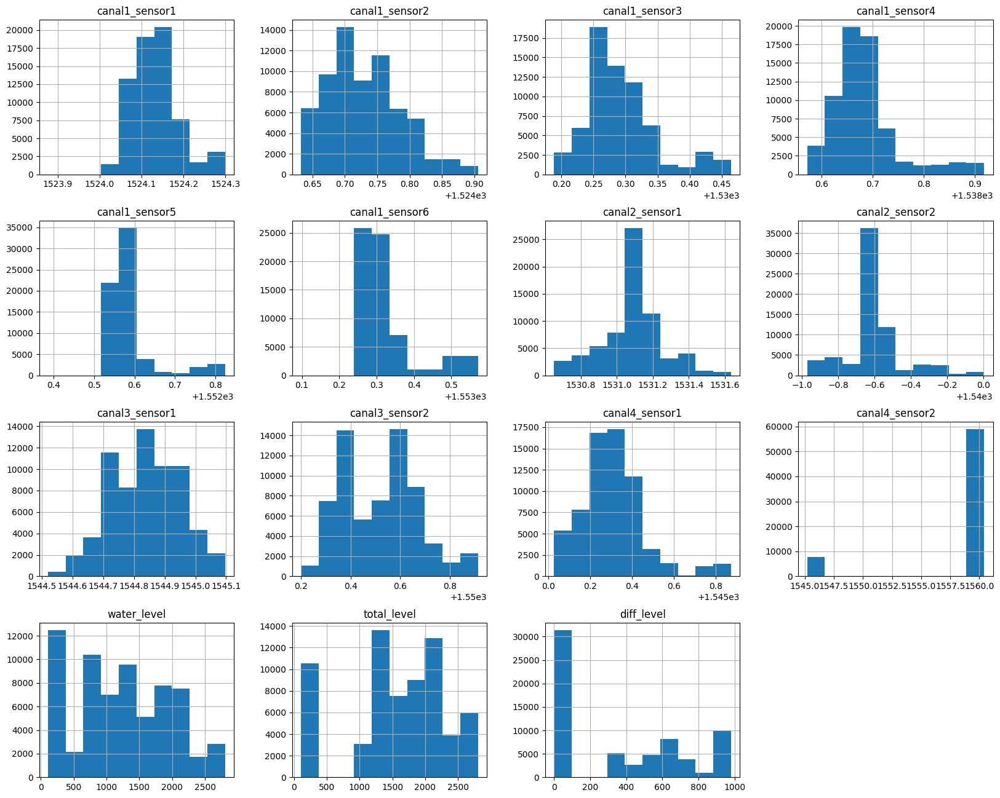

In [15]:
_ = df[
    [
        col for col in df.columns.to_list() if col not in [
            'ts_collect'
        ]
    ]
].hist(
    figsize=(20, 16)
)

### BoxPlot

<Axes: >

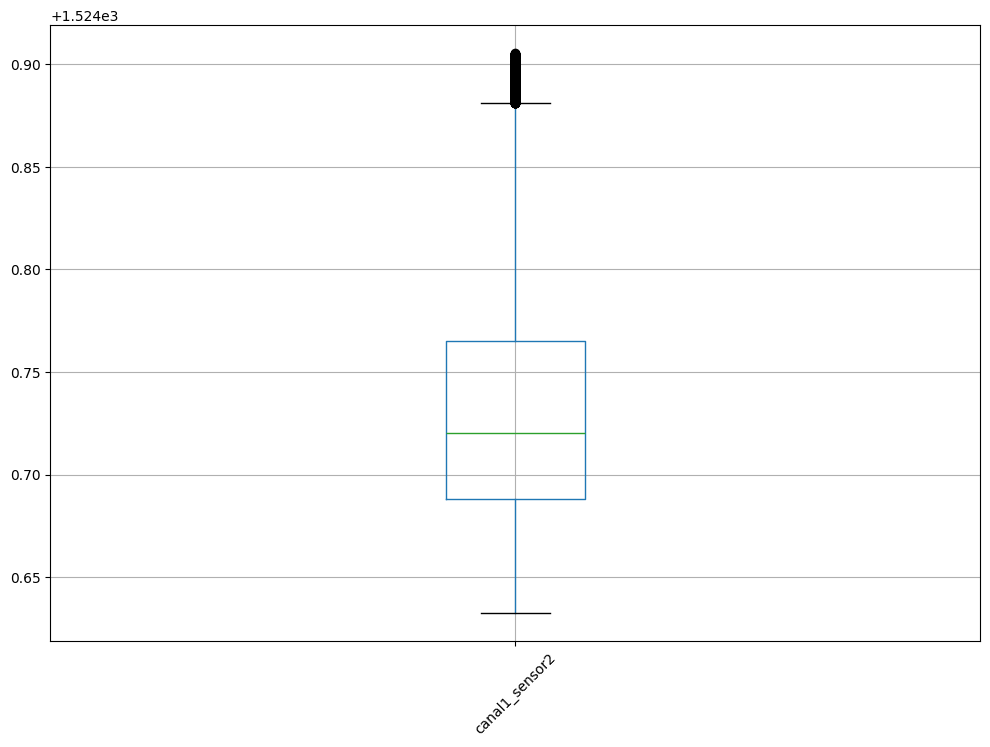

In [16]:
df.boxplot(
    column="canal1_sensor2",
    figsize=(12, 8),
    rot=45
)

### HeatMap

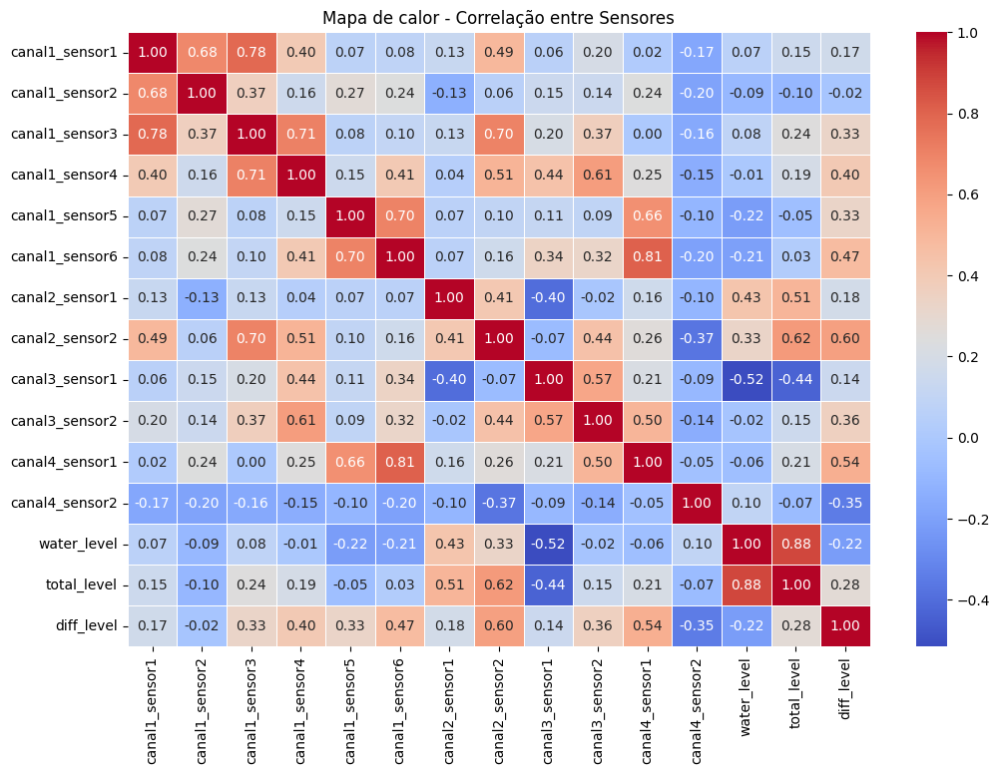

In [17]:
plt.figure(
    figsize=(12, 8)
)
sns.heatmap(
    data=(df.select_dtypes(include="number").drop(columns=["ts_collect"], errors="ignore")).corr(), 
    annot=True, 
    cmap="coolwarm", 
    fmt=".2f", 
    linewidths=0.5
)

plt.title(
    label="Mapa de calor - Correlação entre Sensores"
)
plt.show()

### Series Temporais

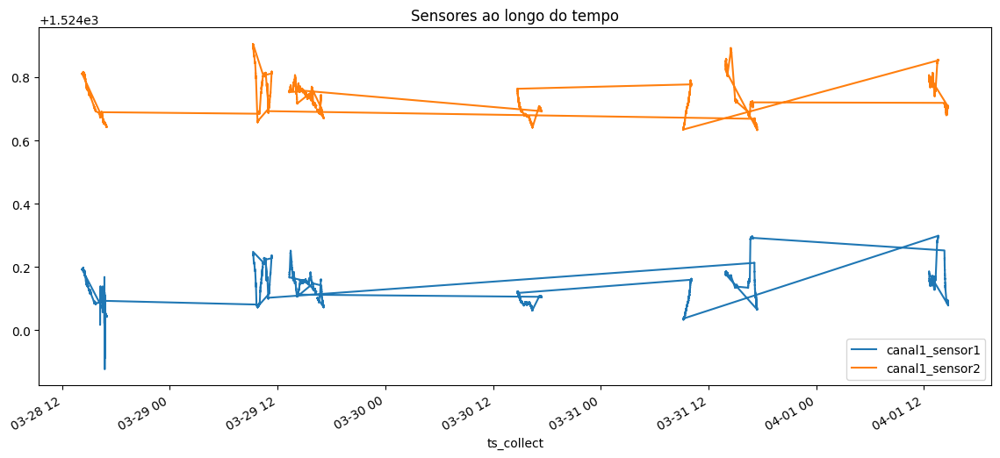

In [18]:
df.set_index(
    "ts_collect"
)[
    [
        "canal1_sensor1", 
        "canal1_sensor2"
    ]
].plot(
    figsize=(14, 6)
)
plt.title(
    label="Sensores ao longo do tempo"
)
plt.show()

### PairPlot - Relações BiVariadas

In [26]:
plt.figure(
    figsize=(36, 32)
)
sns.pairplot(
    df.drop(
        columns=[
            "ts_collect"
        ]
    ), 
    diag_kind="kde",
    height=10
)
plt.show()

<Figure size 3600x3200 with 0 Axes>

### Possiveis Outliers

In [20]:
for col in df.drop(columns=["ts_collect"]).columns.to_list():
    q1 = df[col].quantile(0.25)
    q3 = df[col].quantile(0.75)
    iqr = q3 - q1
    outliers = df[(df[col] < q1 - 1.5*iqr) | (df[col] > q3 + 1.5*iqr)]
    print(f"{col}: {len(outliers)} outliers")

canal1_sensor1: 3132 outliers
canal1_sensor2: 464 outliers
canal1_sensor3: 4399 outliers
canal1_sensor4: 4975 outliers
canal1_sensor5: 6221 outliers
canal1_sensor6: 7884 outliers
canal2_sensor1: 6924 outliers
canal2_sensor2: 16924 outliers
canal3_sensor1: 0 outliers
canal3_sensor2: 0 outliers
canal4_sensor1: 2741 outliers
canal4_sensor2: 12451 outliers
water_level: 0 outliers
total_level: 0 outliers
diff_level: 0 outliers


### PCA - Redução de Dimensionalidade

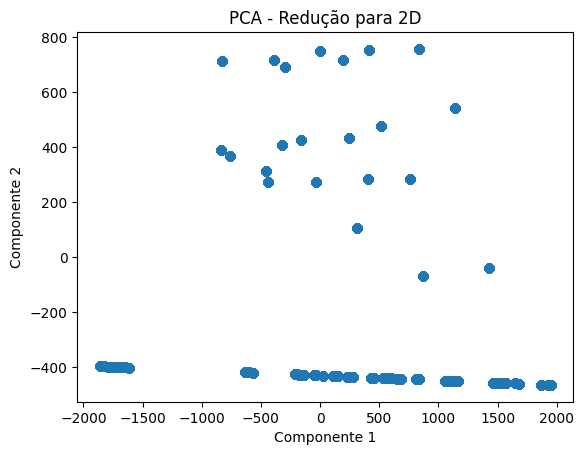

In [21]:

X = df.drop(
    columns=[
        "ts_collect"
    ]
).select_dtypes(
    "number"
).dropna()

pca = PCA(
    n_components=2
)

X_pca = pca.fit_transform(
    X=X
)

plt.scatter(
    X_pca[:, 0], 
    X_pca[:, 1]
)

plt.title(
    label="PCA - Redução para 2D"
)

plt.xlabel(
    xlabel="Componente 1"
)

plt.ylabel(
    ylabel="Componente 2"
)

plt.show()

### Correlações com a Variável-Alvo

In [22]:
corr_target = df.corr()[
    "water_level"
].sort_values(
    ascending=False
)
print(corr_target)

water_level       1.000000
total_level       0.877494
canal2_sensor1    0.426998
canal2_sensor2    0.329347
canal4_sensor2    0.099565
canal1_sensor3    0.084787
canal1_sensor1    0.068816
ts_collect       -0.002571
canal1_sensor4   -0.005676
canal3_sensor2   -0.024552
canal4_sensor1   -0.058571
canal1_sensor2   -0.092020
canal1_sensor6   -0.206934
diff_level       -0.218028
canal1_sensor5   -0.218875
canal3_sensor1   -0.515413
Name: water_level, dtype: float64


### Possivel Clusterização

<Axes: xlabel='canal1_sensor1', ylabel='canal2_sensor1'>

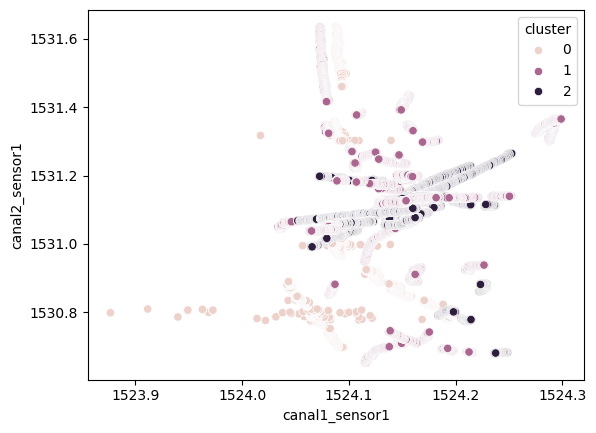

In [ ]:
X = df.drop(columns=["ts_collect"])
kmeans = KMeans(n_clusters=3)
df['cluster'] = kmeans.fit_predict(X)
sns.scatterplot(x="canal1_sensor1", y="canal2_sensor1", hue="cluster", data=df)

### Análise de variação

In [ ]:
variances = df.drop(columns=["ts_collect"]).var()
variances.sort_values(ascending=False)

total_level       555900.793208
water_level       538948.881041
diff_level        134241.119312
canal4_sensor2        21.022585
cluster                0.499862
canal2_sensor1         0.027827
canal2_sensor2         0.024988
canal4_sensor1         0.022995
canal3_sensor2         0.022594
canal3_sensor1         0.012215
canal1_sensor6         0.005917
canal1_sensor4         0.004301
canal1_sensor5         0.003713
canal1_sensor3         0.003145
canal1_sensor2         0.003093
canal1_sensor1         0.002998
dtype: float64